<a href="https://colab.research.google.com/github/duybluemind1988/Data-science/blob/master/Analyze_bigdata2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!apt-get update
!apt-get install openjdk-8-jdk-headless -qq > /dev/null 
!wget -q https://downloads.apache.org/spark/spark-3.0.0/spark-3.0.0-bin-hadoop3.2.tgz
!tar -xvf spark-3.0.0-bin-hadoop3.2.tgz
!pip install -q findspark

In [ ]:
import pandas as pd
import numpy as np

import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.0.0-bin-hadoop3.2"

import numpy as np
import pandas as pd
import findspark
findspark.init()
from pyspark.sql import SparkSession

spark = SparkSession.builder.master("local[*]").getOrCreate()

In [ ]:
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 2gb
df = spark.read.option("delimiter", "\t").csv(path)
df.show(5)

+--------+---+-------+---+-------+------------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+------+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+---------+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|     _c0|_c1|    _c2|_c3|    _c4|               _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_

In [ ]:
df.groupBy('_c2').count().show()

+--------------+-------+
|           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+



In [ ]:
product='CP_SU3032_0112'
df_product=df.filter(df._c2 == product)
df_product.show(5)

+-------+--------------------+--------------+----+-------+-----------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+-------+-------+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|    _c0|                 _c1|           _c2| _c3|    _c4|              _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_c30|_c31|_c

In [ ]:
data_array=np.array(df_product.select('_c40').collect())
data_array

array([['119.46'],
       ['119.84'],
       ['119.38'],
       ...,
       ['118.73'],
       ['119.88'],
       ['120.09']], dtype='<U6')

In [ ]:
date_array=np.array(df_product.select('_c5').collect())
date_array

array([['1/16/2018 7:41:45'],
       ['1/16/2018 7:41:55'],
       ['1/16/2018 7:42:4'],
       ...,
       ['9/16/2019 8:3:25'],
       ['9/16/2019 8:3:30'],
       ['9/16/2019 8:3:36']], dtype='<U19')

In [ ]:
import plotly.graph_objs as go

In [ ]:
df_sub=pd.DataFrame(data_array)
df_sub.head()

,0
0,119.46
1,119.84
2,119.38
3,119.67
4,119.69


In [ ]:
import plotly.express as px
fig=px.histogram(df_sub,x=df_sub[0])
fig.show()

In [ ]:
fig = px.line(x=pd.DataFrame(date_array)[0], y=pd.DataFrame(data_array)[0])
fig.show()

# Combine to one

In [ ]:
import plotly.express as px

           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+

In [ ]:
product='CP_SU3032_0112'
df_product=df.filter(df._c2 == product)
data_array=np.array(df_product.select('_c40').collect())
date_array=np.array(df_product.select('_c5').collect())

In [ ]:
len(data_array)

13088

In [ ]:
fig = px.line(x=pd.DataFrame(date_array)[0], y=pd.DataFrame(data_array)[0])
fig.show()

In [ ]:
fig=px.histogram(x=pd.DataFrame(data_array)[0])
fig.show()

In [ ]:
import plotly.graph_objects as go
#for i in range(len(data_array)):
fig = go.Figure()
for i in range(100):
  date_array_=date_array[i]
  data_array_=data_array[i]
  fig.add_trace(go.Scatter(x=pd.DataFrame(date_array_)[0], y=pd.DataFrame(data_array_)[0],
                    mode='markers',line=dict( color='#4280F5')
                    ))
fig.show()

# Final

## Prepare data

In [ ]:
import pandas as pd
import numpy as np

import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.0.0-bin-hadoop3.2"

import numpy as np
import pandas as pd
import datetime
from dateutil.parser import parse
import findspark
findspark.init()
from pyspark.sql import SparkSession

spark = SparkSession.builder.master("local[*]").getOrCreate()

In [ ]:
%%time
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 1.88 gb
df = spark.read.option("delimiter", "\t").csv(path)
df.show(5)

+--------+---+-------+---+-------+------------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+------+------+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+---------+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|     _c0|_c1|    _c2|_c3|    _c4|               _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|_c28|_c29|_

In [ ]:
%%time
print((df.count(), len(df.columns)))

(3085461, 136)
CPU times: user 61.9 ms, sys: 4.21 ms, total: 66.1 ms
Wall time: 10.7 s


In [ ]:
%%time
product_type='_c2'
df.groupBy(product_type).count().show()
# Take 39s to analyze one column

+--------------+-------+
|           _c2|  count|
+--------------+-------+
|CP_SU3032_0112|  13088|
|CP_SU3037_0112|      1|
|     EST65DB01|      2|
|          5820|     75|
|          null|     89|
|  tSU3037_0112|     45|
|   su3032_0112|   1726|
|  su3037_0112t|      3|
|   SU3032_0112| 521965|
|  SU3037_0112t|    342|
|   SU3036_0110| 208614|
|   SU2010_0112|    305|
|       33ae015|     10|
|   SU3037_0112|2331513|
|   su3036_0110|    533|
|  t-su_ritep01|      1|
|          5070|      3|
|cp_su3032_0112|     50|
|       33AE015|      1|
|   su3037_0112|   7095|
+--------------+-------+

CPU times: user 7.04 ms, sys: 678 µs, total: 7.72 ms
Wall time: 24.1 s


In [ ]:
%%time
product='SU3037_0112' #CP_SU3032_0112 : just 13088 row
df_product=df.filter(df._c2 == product)
df_product.show(5) 
# Take 14 min for filter one item config (~ 2tr3 rows)

+-------+--------------------+-----------+----+-------+-----------------+---+---+---+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+----+-----+----+----+----+----+----+----+----+-----+------+------+------+----+----+----+----+----+----+----+----+----+----+----+-----+----+-----+----+------+-------+----+------+-------+----+-------+-------+----+-------+-------+----+-------+------+----+-------+-------+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+----+-----+----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+-----+--------+--------+--------+--------+-----+-----+-----+-----+-----+
|    _c0|                 _c1|        _c2| _c3|    _c4|              _c5|_c6|_c7|_c8| _c9|_c10|_c11|_c12|_c13|_c14|_c15|_c16|_c17|_c18|_c19|_c20|_c21|_c22|_c23|_c24|_c25|_c26|_c27|

In [ ]:
%%time
df_product.describe().show() # take 8 min for 2331506 row and 136 column analyze

+-------+-------+------------------+-----------+-----------------+--------------------+----------------+--------------------+-------+-------+------------------+-------+-------+-----------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-----------------+-------+-------+-------+-------+-------+-------+-------+------------------+------------------+------------------+------------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+------------------+------------------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+-------+---

In [ ]:
%%time
print((df_product.count(), len(df_product.columns)))

(2331513, 136)
CPU times: user 4.71 ms, sys: 1.63 ms, total: 6.34 ms
Wall time: 20.6 s


In [ ]:
%%time
value_column='_c40'
time_column='_c5'

df_product_select=df_product.select(time_column,value_column).collect()

CPU times: user 9.88 s, sys: 1.07 s, total: 10.9 s
Wall time: 35.8 s


In [ ]:
print(len(df_product_select))
df_product_select[:3]

2331513


[Row(_c5='1/12/2018 14:6:39', _c40='115.16'),
 Row(_c5='1/12/2018 14:6:53', _c40='114.93'),
 Row(_c5='1/12/2018 14:7:1', _c40='115.06')]

In [ ]:
%%time
df_product_new=pd.DataFrame(df_product_select,columns=['Date','Value']).reset_index(drop=True)
df_product_new.head()

CPU times: user 760 ms, sys: 135 ms, total: 894 ms
Wall time: 897 ms


In [ ]:
%%time
df_product_new['Date_new']=df_product_new['Date'].apply(lambda x: parse(x) )
df_product_new['Date_new']=df_product_new['Date_new'].apply(lambda x: x.date() )

CPU times: user 2min 43s, sys: 910 ms, total: 2min 44s
Wall time: 2min 45s


In [ ]:
df_product_new.head()

,Date,Value,Date_new
0,1/12/2018 14:6:39,115.16,2018-01-12
1,1/12/2018 14:6:53,114.93,2018-01-12
2,1/12/2018 14:7:1,115.06,2018-01-12
3,1/12/2018 14:7:18,115.22,2018-01-12
4,1/12/2018 14:7:22,114.96,2018-01-12


In [ ]:
%%time
df_product_new['Value']=df_product_new['Value'].astype('float')

CPU times: user 264 ms, sys: 970 µs, total: 265 ms
Wall time: 268 ms


## Box plot chart

Khong vẽ được do tràn bộ nhớ, tìm phương án khác vẽ box plot

In [ ]:
#fig = go.Figure()
#fig.add_trace(go.Box(x=df_product_new.Date_new, y=df_product_new.Value,line=dict(color='#4280F5')))
#ig.show()


## Line chart

In [ ]:
%%time
df_product_new_agg=df_product_new.groupby(['Date_new']).agg({'Value':['mean','std']})
df_product_new_agg.head()

CPU times: user 441 ms, sys: 3.99 ms, total: 445 ms
Wall time: 451 ms


In [ ]:
df_product_new_agg.columns

MultiIndex([('Value', 'mean'),
            ('Value',  'std')],
           )

In [ ]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(rows=2,cols=1,
    subplot_titles=(['mean','std']))

# Add traces
fig.add_trace(
    go.Scatter(x=df_product_new_agg.index, y=df_product_new_agg['Value','mean'],
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers'),
   row=1,col=1
)

fig.add_trace(
    go.Scatter(x=df_product_new_agg.index, y=df_product_new_agg['Value','std'],
               name="Std",line=dict( color='#4280F5'),mode='lines+markers'),
    row=2,col=1
)


fig.show()

CPU times: user 792 ms, sys: 182 ms, total: 974 ms
Wall time: 992 ms


## Add UCL, LCL, MEAN

In [ ]:
%%time
sigma=3
temp=df_product_new_agg['Value','mean']
temp_std=df_product_new_agg['Value','std']
df_final = df_product_new_agg.assign(
              UCL=temp.mean() + temp.std()*sigma,
              LCL=temp.mean() - temp.std()*sigma,
              mean=temp.mean(),
              UCL_std=temp_std.mean() + temp_std.std()*sigma
              )
df_final.head()

CPU times: user 9.15 ms, sys: 0 ns, total: 9.15 ms
Wall time: 9.58 ms


In [ ]:
df_final.columns

MultiIndex([(  'Value', 'mean'),
            (  'Value',  'std'),
            (    'UCL',     ''),
            (    'LCL',     ''),
            (   'mean',     ''),
            ('UCL_std',     '')],
           )

In [ ]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(rows=2,cols=1,
    subplot_titles=(['mean','std']))

# Add traces
fig.add_trace(
    go.Scatter(x=df_final.index, y=df_final['Value','mean'],
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers'),
   row=1,col=1
)

fig.append_trace(go.Scatter(x=df_final.index, y=df_final['UCL',''],name='UCL ',
                            line=dict( color='#33C2FF')),row=1, col=1)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['LCL',''],name='LCL ', 
                            line=dict( color='#33C2FF')),row=1, col=1)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['mean',''],name='mean ', 
                            line=dict( color='#33C2FF')),row=1, col=1)


fig.add_trace(
    go.Scatter(x=df_final.index, y=df_final['Value','std'],
               name="Std",line=dict( color='#4280F5'),mode='lines+markers'),
    row=2,col=1
)
fig.append_trace(go.Scatter(x=df_final.index, y=df_final['UCL_std',''],name='UCL_std ', 
                            line=dict( color='#33C2FF')),row=2, col=1)


fig.show()

CPU times: user 337 ms, sys: 8 ms, total: 345 ms
Wall time: 354 ms


## Box chart

In [ ]:
df_product_new

,Date,Value,Date_new
0,1/12/2018 14:6:39,115.16,2018-01-12
1,1/12/2018 14:6:53,114.93,2018-01-12
2,1/12/2018 14:7:1,115.06,2018-01-12
3,1/12/2018 14:7:18,115.22,2018-01-12
4,1/12/2018 14:7:22,114.96,2018-01-12
...,...,...,...
2331508,9/20/2019 18:51:52,116.28,2019-09-20
2331509,9/20/2019 18:51:58,115.90,2019-09-20
2331510,9/20/2019 18:52:4,116.63,2019-09-20
2331511,9/20/2019 18:52:11,116.17,2019-09-20


In [ ]:
date_list=df_product_new['Date_new'].unique().tolist()
print(len(date_list))

596


In [ ]:
date_list[0]

datetime.date(2018, 1, 12)

In [ ]:
df_product_new.loc[df_product_new.Date_new==date_list[2]]

,Date,Value,Date_new
7420,1/14/2018 0:0:0,116.04,2018-01-14
7421,1/14/2018 0:0:7,116.34,2018-01-14
7422,1/14/2018 0:0:13,115.51,2018-01-14
7423,1/14/2018 0:0:19,116.39,2018-01-14
7424,1/14/2018 0:0:26,115.67,2018-01-14
...,...,...,...
10404,1/14/2018 13:23:17,115.46,2018-01-14
10405,1/14/2018 13:23:23,115.44,2018-01-14
10406,1/14/2018 13:23:30,115.48,2018-01-14
10407,1/14/2018 13:23:37,115.62,2018-01-14


In [ ]:
range(1,3)

range(1, 3)

In [ ]:
#import plotly.graph_objects as go
#fig = go.Figure()
#for i in range(1,len(date_list)):
#  df_temp=df_product_new.loc[df_product_new.Date_new==date_list[i]]
#  fig.add_trace(go.Box(
#                          x=df_temp.Date_new, y=df_temp.Value,
#                          name='mean ', line=dict( color='#4280F5')
#                          )
#                )
#  if i%100 ==0: 
#    fig.show()
#    fig = go.Figure()

#fig.show()

## Histogram

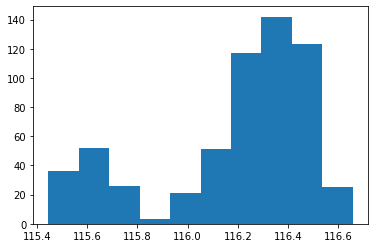

In [ ]:
import matplotlib.pyplot as plt
plt.hist(df_final['Value','mean'])
plt.show()

# Handy spark

In [ ]:
from handyspark import *

ModuleNotFoundError: ignored

In [ ]:
hdf = df_product.toHandy()

In [ ]:
value_column='_c40'
time_column='_c5'
hdf_select=hdf.cols[[time_column,value_column]]
hdf_select[:5]

In [ ]:
hdf.cols['_c40'].hist()

# Dask

In [ ]:
!python -m pip install "dask[complete]"    # Install everything

In [1]:
from dask.distributed import Client
client = Client(n_workers=4)
import dask
import dask.dataframe as dd

In [3]:
%%time
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 1.88 gb
df = dd.read_csv(path,sep='\t',header=None)
df.head()

CPU times: user 443 ms, sys: 39 ms, total: 482 ms
Wall time: 5.03 s


In [4]:
df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135
0,DEAFAULT,1,33AE015,11,0.0477,12/22/2017 8:44:4,1,0,300,2.34,0,450,1.71,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,49.22,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-57.10,...,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,205471440,2,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0,0,NaN
1,DEAFAULT,1,33ae015,11,0.0477,12/22/2017 8:44:53,1,0,300,2.35,0,450,1.76,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,48.94,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-57.10,...,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,205668048,1,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0,0,NaN
2,DEAFAULT,1,33ae015,11,0.0477,12/22/2017 8:45:15,1,0,300,2.33,0,450,1.88,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,49.06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-57.19,...,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,205668048,1,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0,0,NaN
3,DEAFAULT,1,33ae015,11,0.0477,12/22/2017 8:45:54,1,0,300,2.32,0,450,1.86,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,49.67,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-57.13,...,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,205668048,1,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0,0,NaN
4,DEAFAULT,1,33ae015,11,0.0477,12/22/2017 8:46:28,1,0,300,2.36,0,450,1.83,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,0,0,0.0,48.54,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-57.13,...,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,0.0,0.0,-1,205668048,1,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0,0,NaN


dtype={10: 'float64',
       102: 'float64',
       105: 'float64',
       108: 'float64',
       11: 'float64',
       111: 'float64',
       114: 'float64',
       115: 'float64',
       116: 'float64',
       117: 'float64',
       118: 'float64',
       119: 'float64',
       120: 'float64',
       121: 'float64',
       122: 'float64',
       123: 'float64',
       124: 'float64',
       125: 'float64',
       126: 'float64',
       13: 'float64',
       131: 'float64',
       132: 'float64',
       133: 'float64',
       134: 'float64',
       14: 'float64',
       16: 'float64',
       17: 'float64',
       19: 'float64',
       20: 'float64',
       22: 'float64',
       23: 'float64',
       25: 'float64',
       26: 'float64',
       28: 'float64',
       29: 'float64',
       3: 'float64',
       4: 'object',
       57: 'float64',
       6: 'float64',
       60: 'float64',
       63: 'float64',
       66: 'float64',
       69: 'float64',
       7: 'float64',
       72: 'float64',
       75: 'float64',
       78: 'float64',
       8: 'float64',
       81: 'float64',
       84: 'float64',
       87: 'float64',
       90: 'float64',
       93: 'float64',
       96: 'float64',
       99: 'float64'}

- Specify dtypes directly using the dtype keyword. This is the recommended solution, as it’s the least error prone (better to be explicit than implicit) and also the most performant.

- Increase the size of the sample keyword (in bytes)

- Use assume_missing to make dask assume that columns inferred to be int (which don’t allow missing values) are actually floats (which do allow missing values). In our particular case this doesn’t apply.

In [6]:
%%time
df = dd.read_csv(path,sep='\t',header=None,
                 dtype={10: 'float64', 102: 'float64', 105: 'float64', 108: 'float64', 11: 'float64', 111: 'float64', 114: 'float64', 115: 'float64', 116: 'float64', 117: 'float64', 118: 'float64', 119: 'float64', 120: 'float64', 121: 'float64', 122: 'float64', 123: 'float64', 124: 'float64', 125: 'float64', 126: 'float64', 13: 'float64', 131: 'float64', 132: 'float64', 133: 'float64', 134: 'float64', 14: 'float64', 16: 'float64', 17: 'float64', 19: 'float64', 20: 'float64', 22: 'float64', 23: 'float64', 25: 'float64', 26: 'float64', 28: 'float64', 29: 'float64', 3: 'float64', 4: 'object', 57: 'float64', 6: 'float64', 60: 'float64', 63: 'float64', 66: 'float64', 69: 'float64', 7: 'float64', 72: 'float64', 75: 'float64', 78: 'float64', 8: 'float64', 81: 'float64', 84: 'float64', 87: 'float64', 90: 'float64', 93: 'float64', 96: 'float64', 99: 'float64'})
df.head()

CPU times: user 318 ms, sys: 40.2 ms, total: 358 ms
Wall time: 1.47 s


In [7]:
%%time
len(df)

CPU times: user 1.59 s, sys: 191 ms, total: 1.78 s
Wall time: 29.8 s


3085461

In [8]:
%%time
df.tail()

CPU times: user 51.7 ms, sys: 3.88 ms, total: 55.6 ms
Wall time: 674 ms


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135
51990,C67LSG2,small m2 wk39 rwnt,SU3032_0112,19787.0,0.01366,9/20/2019 19:52:10,1.0,0.0,933.0,3.20,0.0,1400.0,2.22,0.0,933.0,3.62,0.0,1400.0,3.30,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,161.86,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
51991,C67LSG2,small m2 wk39 rwnt,SU3032_0112,19787.0,0.01366,9/20/2019 19:52:19,1.0,0.0,933.0,4.29,0.0,1400.0,2.72,0.0,933.0,4.95,0.0,1400.0,4.46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,163.65,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.0,30.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
51992,C67LSG2,small m2 wk39 rwnt,SU3032_0112,19787.0,0.01366,9/20/2019 19:52:27,1.0,0.0,933.0,2.82,0.0,1400.0,0.75,0.0,933.0,3.08,0.0,1400.0,0.98,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,162.52,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
51993,C67LSG2,small m2 wk39 rwnt,SU3032_0112,19787.0,0.01366,9/20/2019 19:52:34,1.0,0.0,933.0,2.99,0.0,1400.0,1.34,0.0,933.0,3.52,0.0,1400.0,2.33,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,164.35,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
51994,C67LSG2,small m2 wk39 rwnt,SU3032_0112,19787.0,0.01366,9/20/2019 19:52:42,1.0,0.0,933.0,4.10,0.0,1400.0,1.69,0.0,933.0,4.58,0.0,1400.0,2.26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
%%time
df[12].max().compute()

CPU times: user 1.41 s, sys: 163 ms, total: 1.58 s
Wall time: 27.7 s


984.73

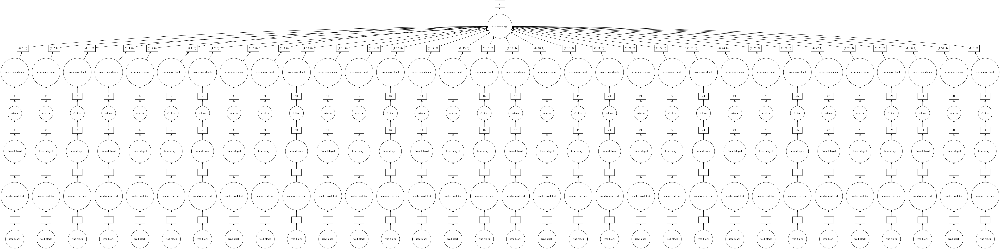

In [ ]:
# notice the parallelism
df[12].max().visualize()

In [10]:
%%time
value_count=df[2].value_counts().compute()
value_count

CPU times: user 1.47 s, sys: 183 ms, total: 1.66 s
Wall time: 28.2 s


In [11]:
value_count

SU3037_0112       2331513
SU3032_0112        521965
SU3036_0110        208614
CP_SU3032_0112      13088
su3037_0112          7095
su3032_0112          1726
su3036_0110           533
SU3037_0112t          342
SU2010_0112           305
5820                   75
cp_su3032_0112         50
tSU3037_0112           45
33ae015                10
su3037_0112t            3
5070                    3
EST65DB01               2
CP_SU3037_0112          1
t-su_ritep01            1
33AE015                 1
Name: 2, dtype: int64

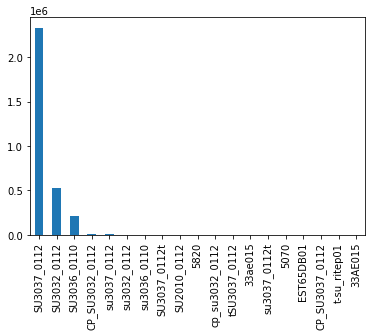

In [12]:
value_count.plot(kind='bar')

In [13]:
%%time
df_filter=df[df[2]=='CP_SU3032_0112'].compute() # just 13000 rows
df_filter

CPU times: user 1.59 s, sys: 214 ms, total: 1.8 s
Wall time: 28.5 s


In [14]:
import datetime
from dateutil.parser import parse

In [15]:
%%time
df_filter[5]=df_filter[5].apply(lambda x: parse(x) )
df_filter[5]=df_filter[5].apply(lambda x: x.date() )

CPU times: user 1.3 s, sys: 21.2 ms, total: 1.32 s
Wall time: 1.33 s


In [20]:
df_filter.loc[:,:80]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80
19604,DEFAULT,CP_SU3032_0112_58536396_SMALL_M1_WK3,CP_SU3032_0112,7117.0,0.01349,2018-01-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,108.021,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
19605,DEFAULT,CP_SU3032_0112_58536396_SMALL_M1_WK3,CP_SU3032_0112,7117.0,0.01349,2018-01-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,108.943,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
19606,DEFAULT,CP_SU3032_0112_58536396_SMALL_M1_WK3,CP_SU3032_0112,7117.0,0.01349,2018-01-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,108.040,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
19607,DEFAULT,CP_SU3032_0112_58536396_SMALL_M1_WK3,CP_SU3032_0112,7117.0,0.01349,2018-01-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,108.640,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
19608,DEFAULT,CP_SU3032_0112_58536396_SMALL_M1_WK3,CP_SU3032_0112,7117.0,0.01349,2018-01-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,108.812,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23569,C67LSG2,CP_SU30320_0112_60719177 small m2 wk38,CP_SU3032_0112,5820.0,0.01366,2019-09-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,107.728,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
23570,C67LSG2,CP_SU30320_0112_60719177 small m2 wk38,CP_SU3032_0112,5820.0,0.01366,2019-09-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,107.995,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
23571,C67LSG2,CP_SU30320_0112_60719177 small m2 wk38,CP_SU3032_0112,5820.0,0.01366,2019-09-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,1400.0,107.731,0.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0
23572,C67LSG2,CP_SU30320_0112_60719177 small m2 wk38,CP_SU3032_0112,5820.0,0.01366,2019-09-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

In [21]:
%%time
df_group_date=df_filter.groupby(5)[59].mean()
df_group_date

CPU times: user 3.68 ms, sys: 841 µs, total: 4.52 ms
Wall time: 6.84 ms


In [22]:
df_group_date

5
2018-01-16    108.563685
2018-01-22    108.373110
2018-01-30    108.158194
2018-02-01    108.517000
2018-02-05    108.426425
                 ...    
2019-08-05    108.926915
2019-08-19    108.733868
2019-08-26    109.037876
2019-09-10    108.908286
2019-09-16    108.352898
Name: 59, Length: 107, dtype: float64

In [23]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig =go.Figure()

# Add traces
fig.add_trace(
    go.Scatter(x=df_group_date.index, y=df_group_date.values,
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers')
)

fig.show()

CPU times: user 166 ms, sys: 7.96 ms, total: 174 ms
Wall time: 177 ms


## Another data group: (best)

In [1]:
from dask.distributed import Client
client = Client(n_workers=4)
import dask
import dask.dataframe as dd

In [4]:
%%time
path='/content/drive/My Drive/Data/Sonion/V04R-V04R-SQLData.dat' # 1.88 gb
df = dd.read_csv(path,sep='\t',header=None,
                 dtype={10: 'float64', 102: 'float64', 105: 'float64', 108: 'float64', 11: 'float64', 111: 'float64', 114: 'float64', 115: 'float64', 116: 'float64', 117: 'float64', 118: 'float64', 119: 'float64', 120: 'float64', 121: 'float64', 122: 'float64', 123: 'float64', 124: 'float64', 125: 'float64', 126: 'float64', 13: 'float64', 131: 'float64', 132: 'float64', 133: 'float64', 134: 'float64', 14: 'float64', 16: 'float64', 17: 'float64', 19: 'float64', 20: 'float64', 22: 'float64', 23: 'float64', 25: 'float64', 26: 'float64', 28: 'float64', 29: 'float64', 3: 'float64', 4: 'object', 57: 'float64', 6: 'float64', 60: 'float64', 63: 'float64', 66: 'float64', 69: 'float64', 7: 'float64', 72: 'float64', 75: 'float64', 78: 'float64', 8: 'float64', 81: 'float64', 84: 'float64', 87: 'float64', 90: 'float64', 93: 'float64', 96: 'float64', 99: 'float64'})
df.head()

CPU times: user 402 ms, sys: 44.7 ms, total: 447 ms
Wall time: 2.8 s


In [5]:
%%time
df[2].value_counts().compute()

CPU times: user 2.53 s, sys: 312 ms, total: 2.84 s
Wall time: 42.3 s


SU3037_0112       2331513
SU3032_0112        521965
SU3036_0110        208614
CP_SU3032_0112      13088
su3037_0112          7095
su3032_0112          1726
su3036_0110           533
SU3037_0112t          342
SU2010_0112           305
5820                   75
cp_su3032_0112         50
tSU3037_0112           45
33ae015                10
su3037_0112t            3
5070                    3
EST65DB01               2
CP_SU3037_0112          1
t-su_ritep01            1
33AE015                 1
Name: 2, dtype: int64

In [6]:
%%time
df_filter=df[df[2]=='SU3037_0112'].compute() # 2 tr rows
df_filter

CPU times: user 5.1 s, sys: 7.14 s, total: 12.2 s
Wall time: 44.8 s


In [7]:
%%time
df_filter.describe()

CPU times: user 8.16 s, sys: 1.47 s, total: 9.64 s
Wall time: 9.3 s


,3,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,...,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135
count,2.331513e+06,2.331513e+06,2331513.0,2331513.0,2.331513e+06,2331513.0,2331513.0,2.331513e+06,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2.331513e+06,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2331513.0,2331513.0,...,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2.331513e+06,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,2331513.0,0.0
mean,9.985860e+03,1.000434e+00,0.0,933.0,3.103666e+00,0.0,1400.0,1.882470e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.733736e+01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-7.602489e+00,1.161813e+02,1.192971e+02,1.269833e+02,0.0,0.0,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,2.910227e+00,2.905062e-01,2.283483e-01,5.699218e-02,4.379216e-02,3.113600e-02,1.712407e-02,8.304479e-03,5.345885e-03,3.327882e-03,1.214233e-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
std,6.501723e+03,4.065484e-02,0.0,0.0,2.502048e+00,0.0,0.0,2.186195e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.076534e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.277865e+00,9.726577e-01,1.037887e+00,1.215421e+00,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.141108e-01,3.165864e+00,4.567470e+00,1.428062e+00,1.150125e+00,9.318482e-01,6.030038e-01,3.061302e-01,1.954171e-01,1.495133e-01,8.404189e-02,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
min,0.000000e+00,0.000000e+00,0.0,933.0,0.000000e+00,0.0,1400.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.798500e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
25%,5.070000e+03,1.000000e+00,0.0,933.0,2.440000e+00,0.0,1400.0,1.070000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.634000e+01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-8.850000e+00,1.159100e+02,1.190400e+02,1.268000e+02,0.0,0.0,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
50%,7.117000e+03,1.000000e+00,0.0,933.0,2.900000e+00,0.0,1400.0,1.630000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.728000e+01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-7.830000e+00,1.162300e+02,1.193000e+02,1.270600e+02,0.0,0.0,...,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,0.0,0.0,-1.0,1.0,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN
75%,1.425800e+04,1.000000e+00,0.0,933.0,3.500000e+00,0.0,1400.0,2.370000e+00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.821000e+01,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-6.720000e+00,1.165000e+02,1.195700e+02,1.272600e+02,0.0,0.0,...,-1.0,0.0,0.0

In [8]:
import datetime
from dateutil.parser import parse

In [9]:
%%time
df_filter[5]=df_filter[5].astype('M8[us]')
df_filter[5]=df_filter[5].dt.date
df_filter[5]

CPU times: user 4min 56s, sys: 5.08 s, total: 5min 1s
Wall time: 5min 2s


In [10]:
df_filter.head().loc[:,:80]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80
11,DEFAULT,58536826 medium m1 wk3,SU3037_0112,7117.0,0.01349,2018-01-12,1.0,0.0,933.0,2.82,0.0,1400.0,1.16,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,78.71,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-7.71,...,118.66,126.59,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,200.0,102.727,0.0,500.0,102.779,0.0,1000.0,104.028,0.0,2838.13,115.013,1.0,6073.00,99.047,2.0,7919.31,103.319,1.0,0.0,0.0,-1.0,0.0,0.0
12,DEFAULT,58536826 medium m1 wk3,SU3037_0112,7117.0,0.01349,2018-01-12,1.0,0.0,933.0,3.00,0.0,1400.0,2.88,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79.18,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-6.45,...,118.56,126.59,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,200.0,102.464,0.0,500.0,102.579,0.0,1000.0,103.883,0.0,2838.13,115.152,1.0,5920.41,99.283,2.0,7812.50,103.375,1.0,0.0,0.0,-1.0,0.0,0.0
13,DEFAULT,58536826 medium m1 wk3,SU3037_0112,7117.0,0.01349,2018-01-12,1.0,0.0,933.0,2.96,0.0,1400.0,2.21,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,78.17,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-6.93,...,118.69,126.42,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,200.0,102.610,0.0,500.0,102.703,0.0,1000.0,104.022,0.0,2838.13,114.898,1.0,6179.81,98.679,2.0,8163.45,103.301,1.0,0.0,0.0,-1.0,0.0,0.0
14,DEFAULT,58536826 medium m1 wk3,SU3037_0112,7117.0,0.01349,2018-01-12,1.0,0.0,933.0,5.35,0.0,1400.0,2.12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,77.80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-6.97,...,118.88,126.92,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,200.0,102.969,0.0,500.0,103.042,0.0,1000.0,104.296,0.0,2883.91,115.407,1.0,6057.74,99.270,2.0,7873.54,103.097,1.0,0.0,0.0,-1.0,0.0,0.0
15,DEFAULT,58536826 medium m1 wk3,SU3037_0112,7117.0,0.01349,2018-01-12,1.0,0.0,933.0,3.40,0.0,1400.0,1.37,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,79.21,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-6.56,...,118.53,126.43,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,0.0,0.0,200.0,102.523,0.0,500.0,102.629,0.0,1000.0,103.871,0.0,2883.91,115.007,1.0,6073.00,99.514,2.0,7843.02,103.554,1.0,0.0,0.0,-1.0,0.0,0.0


In [11]:
%%time
df_group_date=df_filter.groupby(5)[65].mean() # 1 Khz
df_group_date

CPU times: user 639 ms, sys: 23.2 ms, total: 662 ms
Wall time: 674 ms


In [12]:
%%time
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig =go.Figure()

# Add traces
fig.add_trace(
    go.Scatter(x=df_group_date.index, y=df_group_date.values,
               name="Mean",line=dict( color='#FF5733'),mode='lines+markers')
)

fig.show()

CPU times: user 1.96 s, sys: 424 ms, total: 2.38 s
Wall time: 3.68 s
